<a href="https://colab.research.google.com/github/rschabra/ENEE439Dlabs/blob/main/RohanChabraLab2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial 2


In [2]:
import cv2
from google.colab.patches import cv2_imshow as show
import numpy as np
import matplotlib.pyplot as plt

**Read the image 'lena.tif'**


In [3]:
img = cv2.imread("/content/images/lena.tif")

**Convert image from RGB to gray**

Using cvtColor, we converted from RGB to Gray without having to convert to BGR first.[link text](https://)

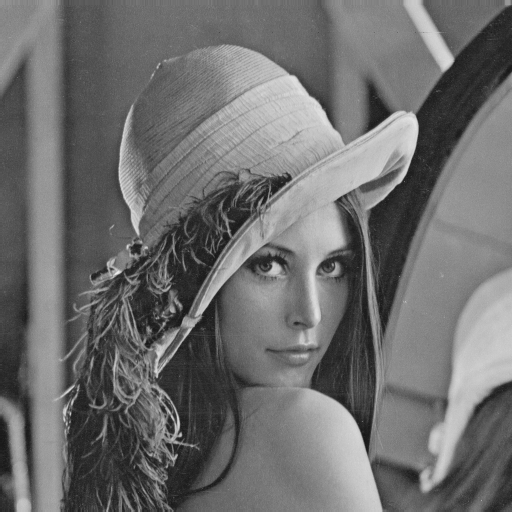

In [3]:
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
show(img_gray)

Create Kernel for LPF with size 3 (Study about [kernels](https://setosa.io/ev/image-kernels/) here)

In [4]:
kernel_size3 = 1/9*np.ones((3,3))

**Implement LPF kernel for image** ***(1 point)***

This goes through each 3x3 section of the image starting at row/column two of the padded image. It convolves our kernel with this region and then stores it as the LPF image.

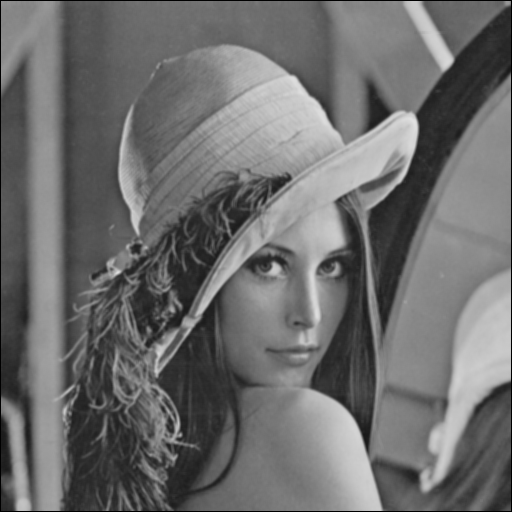

In [5]:
(img_H, img_W) = img_gray.shape[:2]
kernel_H = 3
kernel_W = 3

padded_image = cv2.copyMakeBorder(img_gray, 1,1,1,1, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+2,y-1:y+2]

    convolved_area = (img_area*kernel_size3).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


Change Kernel Size to 5

In [ ]:
kernel_size5 = 1/25*np.ones((5,5))

Implement LPF kernel for image with new kernel size



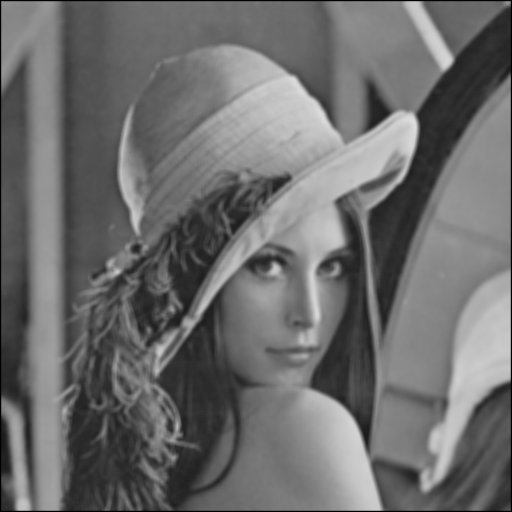

In [ ]:
padded_image = cv2.copyMakeBorder(img_gray, 2,2,2,2, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+4,y-1:y+4]

    convolved_area = (img_area*kernel_size5).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


Change Kernel Size further to 7

In [ ]:
kernel_size7 = 1/49*np.ones((7,7))

Implement LPF kernel for image with new kernel size

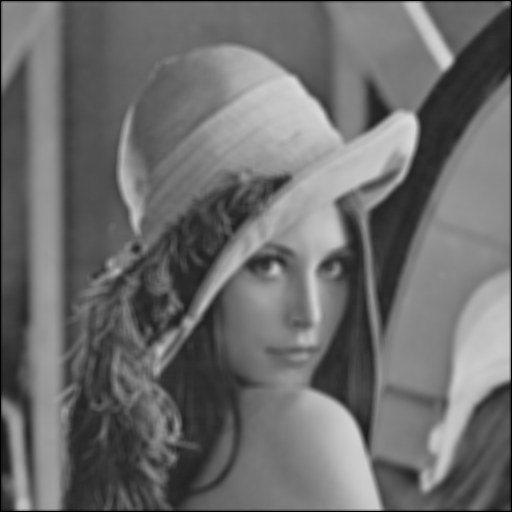

In [ ]:
padded_image = cv2.copyMakeBorder(img_gray, 3,3,3,3, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+6,y-1:y+6]

    convolved_area = (img_area*kernel_size7).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


**Compare and explain how the size of the kernel impacts the images.** ***(2 points)***

As we increased the size of the kernel, the convolved images became increasingly smooth. This is because we are using more and more pixels to determine what a single pixel will be after the convolution. For a size 3 kernel there is only 9 pixels being used, but for size 5 and 7 we use 25 and 49 pixels respectively. Because of this large variety of pixels, sections that have a noticeable contrast end up becoming one shade.

Implement HPF for image

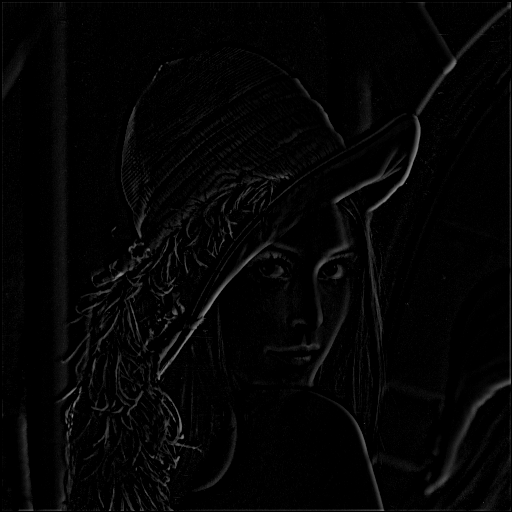

In [ ]:
HPF_kernel = (-1/49)*np.ones((7,7))
HPF_kernel[1,1] = 48/49

padded_image = cv2.copyMakeBorder(img_gray, 3,3,3,3, cv2.BORDER_CONSTANT)
HPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+6,y-1:y+6]

    convolved_area = (img_area*HPF_kernel).sum()

    HPF_image[x-1,y-1] = convolved_area
show(HPF_image)

Sharpen the image using your gray image, your HPF image and a scale size of 2 ***(1 point)***

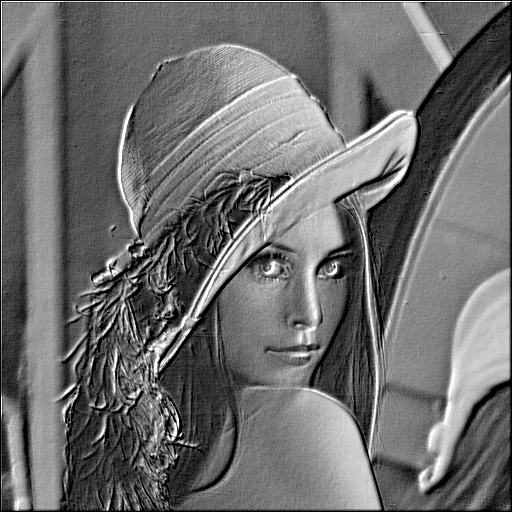

In [ ]:
identity_0 = np.zeros((7,7))
identity_0[3,3]=1
sharpen_kernel = identity_0 - 2*HPF_kernel

padded_image = cv2.copyMakeBorder(img_gray, 3,3,3,3, cv2.BORDER_CONSTANT)
sharpened_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+6,y-1:y+6]

    convolved_area = (img_area*sharpen_kernel).sum()

    sharpened_image[x-1,y-1] = convolved_area
show(sharpened_image)

Edge Detection using Sobel Masks ***(2 points)***

Using the sobel mask (X):

The results are amazing! Edge detection using the sobel mask shows a much higher contrast than the previous results.

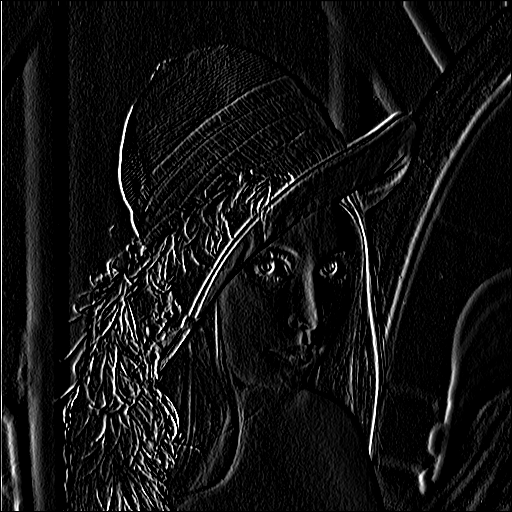

In [15]:
sobel_kernel = [[-1,0,1],[-2,0,2],[-1,0,1]]
padded_image = cv2.copyMakeBorder(img_gray, 2,2,2,2, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+2,y-1:y+2]

    convolved_area = (img_area*sobel_kernel).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


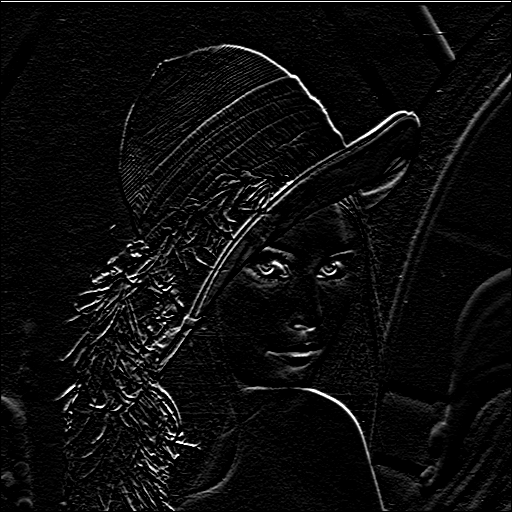

In [16]:
sobel_kernel_y = [[-1,-2,-1],[0,0,0],[1,2,1]]
padded_image = cv2.copyMakeBorder(img_gray, 2,2,2,2, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+2,y-1:y+2]

    convolved_area = (img_area*sobel_kernel_y).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


Edge Detection using Prewitt Masks ***(2 points)***

The Prewitt Mask gives edge detection that looks extremely similar to the Sobel Masks. This makes sense as the kernel is nearly the same (-1,0,1) is the top row of the sobel mask as well.

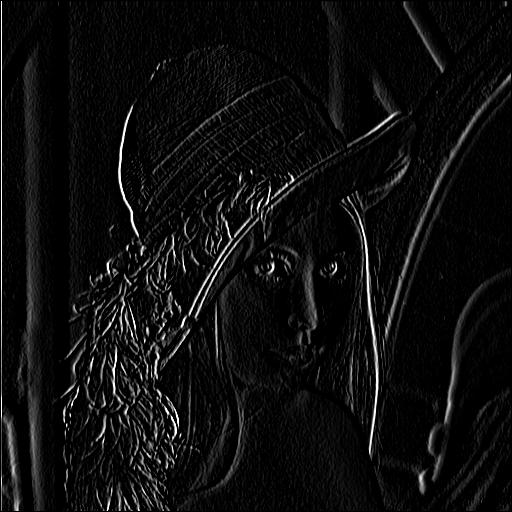

In [17]:
prewitt_kernel = [[-1,0,1],[-1,0,1],[-1,0,1]]
padded_image = cv2.copyMakeBorder(img_gray, 2,2,2,2, cv2.BORDER_CONSTANT)
LPF_image = np.zeros((img_H, img_W))

for y in np.arange(2, img_H):
  for x in np.arange(2, img_W):
    img_area = padded_image[x-1:x+2,y-1:y+2]

    convolved_area = (img_area*prewitt_kernel).sum()

    LPF_image[x-1,y-1] = convolved_area

show(LPF_image)


Stitch multiple pictures together into panaroma using boat pictures from images file (Hint: use cv2.Sticher) ***(2 points)***

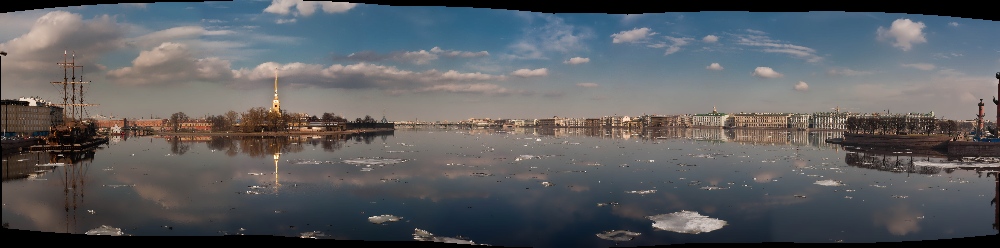

In [5]:
boat1 = cv2.imread("/content/images/boat1.jpeg")
boat2 = cv2.imread("/content/images/boat2.jpeg")
boat3 = cv2.imread("/content/images/boat3.jpeg")
boat4 = cv2.imread("/content/images/boat4.jpeg")
boat5 = cv2.imread("/content/images/boat5.jpeg")
boat6 = cv2.imread("/content/images/boat6.jpeg")
stitcher = cv2.Stitcher_create()
status, img_pano = stitcher.stitch((boat1,boat2,boat3,boat4,boat5,boat6))

show(img_pano)

This result is fantastic! The stitcher library worked well and created a panorama from five images with similar features. 